# Cluster feature space

In [1]:
import sys
print(sys.executable)
print(sys.version)

/home/kshitij98/getNeighbours/venv/bin/python3
3.5.2 (default, Nov 12 2018, 13:43:14) 
[GCC 5.4.0 20160609]


In [2]:
from ipynb.fs.full.Helper import getDataLoader, getNames, dist
from ipynb.fs.full.GramMatrix import convertModel, GramMatrixLayer
from ipynb.fs.full.LabelDataset import createDirectories

import torch
import torch.nn as nn

%matplotlib inline

---

### Save clusters using k-Means

In [ ]:
import time

t = time.time()

names = getNames('/scratch/bam_subset_2_0_features/')
X = []
for i, fileName in enumerate(names):
    X.append(torch.load(fileName))
    print("ETA: ", (len(names) - i - 1) * ((time.time() - t) / (i+1)), end='\r')
X = torch.stack(X, 0)
print(X.shape)

In [4]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=7, random_state=0).fit(X)

In [5]:
print(len(kmeans.labels_))

121000


In [7]:
print(type(kmeans))


<class 'sklearn.cluster.k_means_.KMeans'>


In [ ]:
import numpy as np

np.save('/home/kshitij98/clusters/1-1-1-1-1_11.npy', kmeans.labels_)

In [9]:
import pickle

fileName = '/scratch/kshitij98/cluster1-1-1-1-1_7.pkl'
pickle.dump(kmeans, open(fileName, 'wb'))

---

In [12]:
centers = kmeans.cluster_centers_
print(type(centers))
print(centers.shape)

<class 'numpy.ndarray'>
(7, 1178)


---

In [33]:
import pickle
import numpy as np

labels = None
with open('../bam_2_0_image_style_labels.pkl', 'rb') as handle:
    labels = pickle.load(handle)

names = getNames('/scratch/bam_subset_2_0_labeled/')
kmeansC = np.load('/home/kshitij98/clusters/1-1-1-1-1_7.npy')

In [34]:
for i, l in enumerate(labels):
    print(labels[l])
    
    if i == 10:
        break

2
4
3
1
3
9
4
4
4
2
4


In [ ]:
cluster = {}

for i, name in enumerate(names):
    imgName = name.split('/')[-1]
#     print(imgName, labels[imgName], kmeansC[i])
    
    if cluster.get(kmeansC[i]) is None:
        cluster[kmeansC[i]] = {}
    if cluster[kmeansC[i]].get(labels[imgName]) is None:
        cluster[kmeansC[i]][labels[imgName]] = []
    cluster[kmeansC[i]][labels[imgName]].append(imgName)

    print(i, end='\r')
#     print(cluster.contains(kmeansC[i]))
#     if clusters[kmeansC[i]]:
        
    
#     if i == 0:
#         break

In [63]:
import matplotlib.pyplot as plt
from PIL import Image
%matplotlib inline


def showImages(images):
    fig = plt.figure(figsize=(32, 32))
    columns = 5
    rows = 4
    for i in range(1, len(images) + 1):
        img = images[i-1]
        fig.add_subplot(rows, columns, i)
        plt.imshow(img)
    plt.show()

In [62]:
for c in cluster:
    print("\nCluster #", c + 1)
    total = 0
    maxL = -1
    maxC = 0
    for l in cluster[c]:
        total += len(cluster[c][l])
        if len(cluster[c][l]) > maxC:
            maxC = len(cluster[c][l])
            maxL = l
        
#         print(l, " = ", len(cluster[c][l]))

    for l in cluster[c]:
        print(l, " = ", len(cluster[c][l]), " (", len(cluster[c][l]) * 100 / total, "%)")
    print("Most Dominant Label is ", maxL, " = ", maxC, " / ", total ," (", maxC * 100 / total, "%)")



Cluster # 1
0  =  3553  ( 17.87852865697177 %)
1  =  34  ( 0.1710863986313088 %)
2  =  35  ( 0.17611835153222966 %)
3  =  590  ( 2.9688522115433 %)
4  =  50  ( 0.2515976450460424 %)
5  =  5569  ( 28.0229457052282 %)
6  =  283  ( 1.4240426709605998 %)
7  =  5407  ( 27.20776933527902 %)
8  =  3193  ( 16.067025612640265 %)
9  =  120  ( 0.6038343481105017 %)
10  =  1039  ( 5.228199064056761 %)
Most Dominant Label is  5  =  5569  /  19873  ( 28.0229457052282 %)

Cluster # 2
0  =  696  ( 5.613355915799661 %)
1  =  6869  ( 55.3996290023389 %)
2  =  1436  ( 11.581579159609646 %)
3  =  2192  ( 17.678845068150657 %)
4  =  56  ( 0.4516493265585934 %)
5  =  3  ( 0.024195499637067505 %)
6  =  58  ( 0.46777965964997176 %)
7  =  87  ( 0.7016694894749577 %)
8  =  835  ( 6.734414065650456 %)
9  =  136  ( 1.0968626502137269 %)
10  =  31  ( 0.2500201629163642 %)
Most Dominant Label is  1  =  6869  /  12399  ( 55.3996290023389 %)

Cluster # 3
0  =  890  ( 5.497220506485485 %)
1  =  295  ( 1.8221124150710


Cluster # 1
Most dominant images:


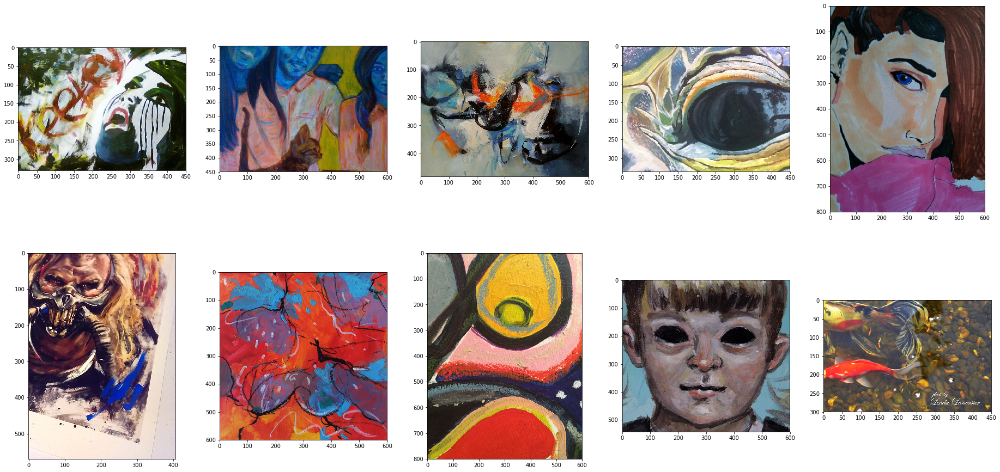

19873  images in total
Randomly sampled images:


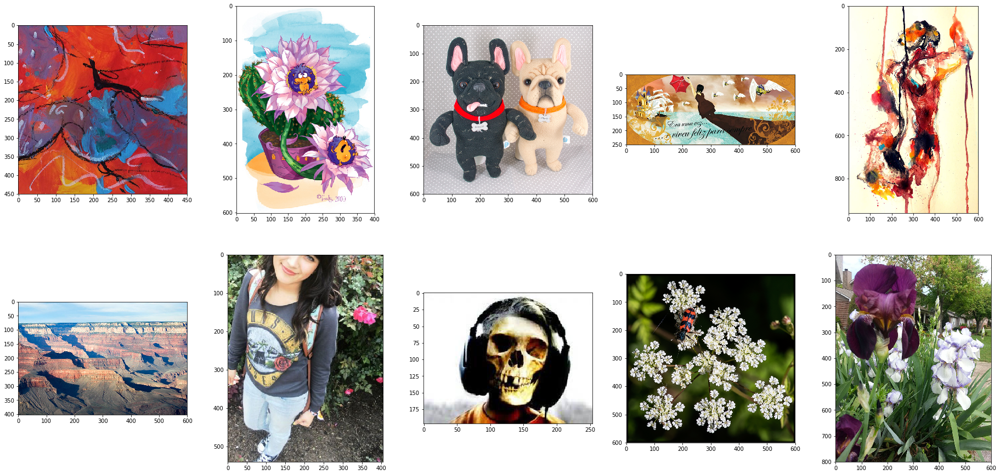

0  =  3553  ( 17.87852865697177 %)
1  =  34  ( 0.1710863986313088 %)
2  =  35  ( 0.17611835153222966 %)
3  =  590  ( 2.9688522115433 %)
4  =  50  ( 0.2515976450460424 %)
5  =  5569  ( 28.0229457052282 %)
6  =  283  ( 1.4240426709605998 %)
7  =  5407  ( 27.20776933527902 %)
8  =  3193  ( 16.067025612640265 %)
9  =  120  ( 0.6038343481105017 %)
10  =  1039  ( 5.228199064056761 %)
Most Dominant Label is  5  =  5569  /  19873  ( 28.0229457052282 %)

Cluster # 2
Most dominant images:


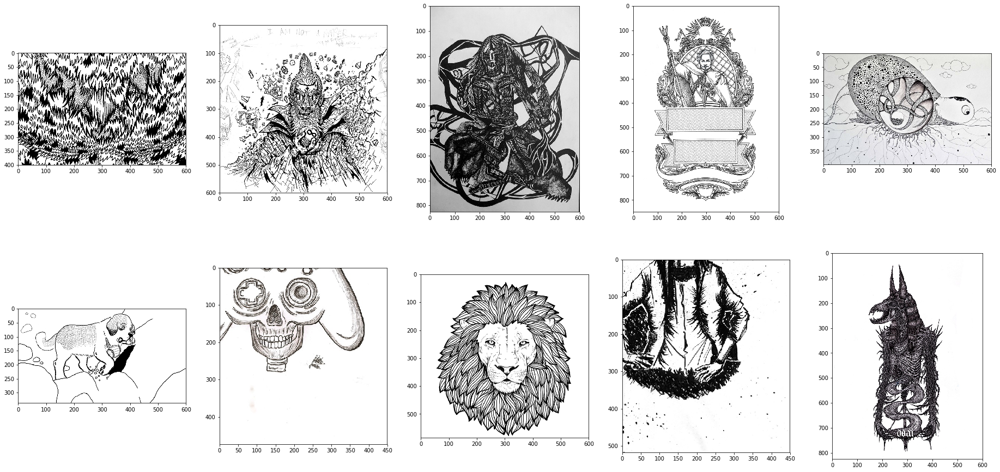

12399  images in total
Randomly sampled images:


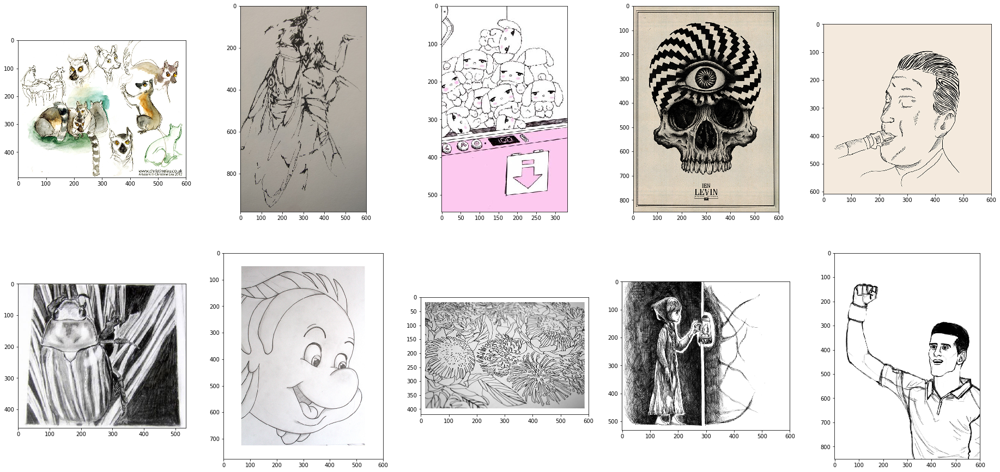

0  =  696  ( 5.613355915799661 %)
1  =  6869  ( 55.3996290023389 %)
2  =  1436  ( 11.581579159609646 %)
3  =  2192  ( 17.678845068150657 %)
4  =  56  ( 0.4516493265585934 %)
5  =  3  ( 0.024195499637067505 %)
6  =  58  ( 0.46777965964997176 %)
7  =  87  ( 0.7016694894749577 %)
8  =  835  ( 6.734414065650456 %)
9  =  136  ( 1.0968626502137269 %)
10  =  31  ( 0.2500201629163642 %)
Most Dominant Label is  1  =  6869  /  12399  ( 55.3996290023389 %)

Cluster # 3
Most dominant images:


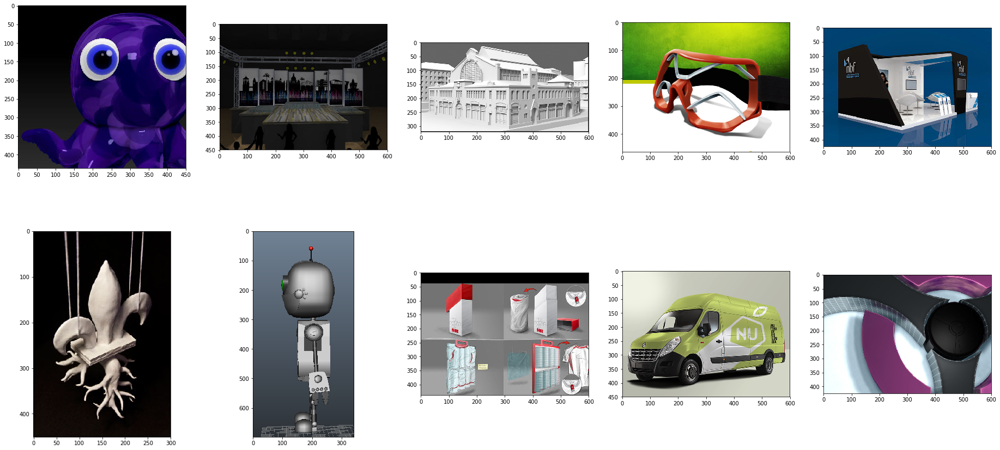

16190  images in total
Randomly sampled images:


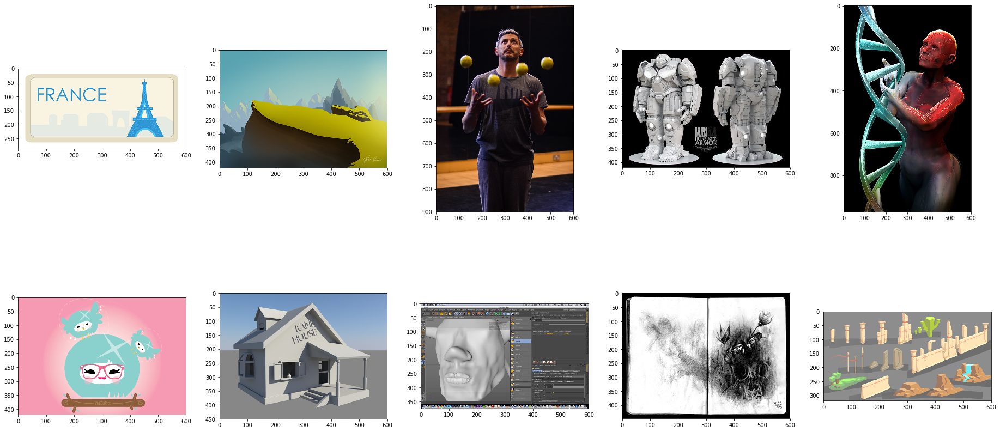

0  =  890  ( 5.497220506485485 %)
1  =  295  ( 1.8221124150710315 %)
2  =  394  ( 2.4336009882643608 %)
3  =  1383  ( 8.542310067943175 %)
4  =  4626  ( 28.573193329215567 %)
5  =  303  ( 1.8715256331068562 %)
6  =  6016  ( 37.15873996294009 %)
7  =  693  ( 4.2804200123533045 %)
8  =  654  ( 4.039530574428659 %)
9  =  533  ( 3.2921556516368127 %)
10  =  403  ( 2.489190858554663 %)
Most Dominant Label is  6  =  6016  /  16190  ( 37.15873996294009 %)

Cluster # 4
Most dominant images:


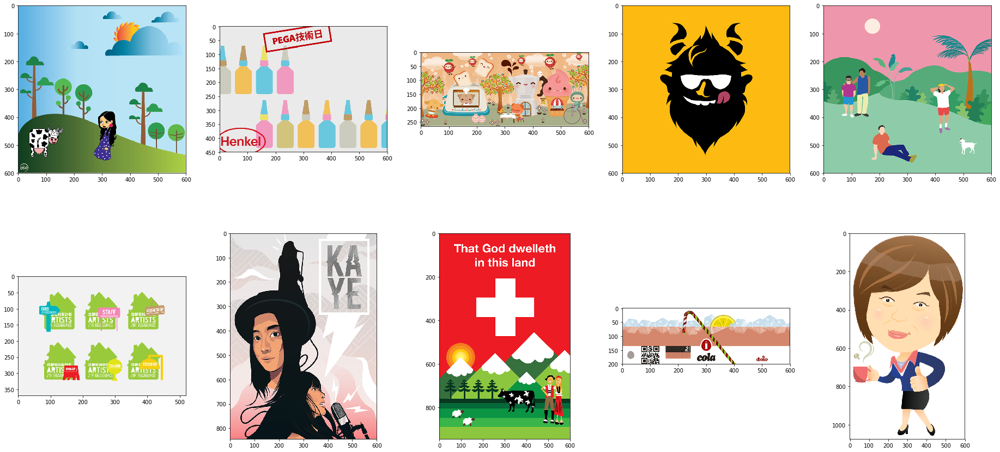

11037  images in total
Randomly sampled images:


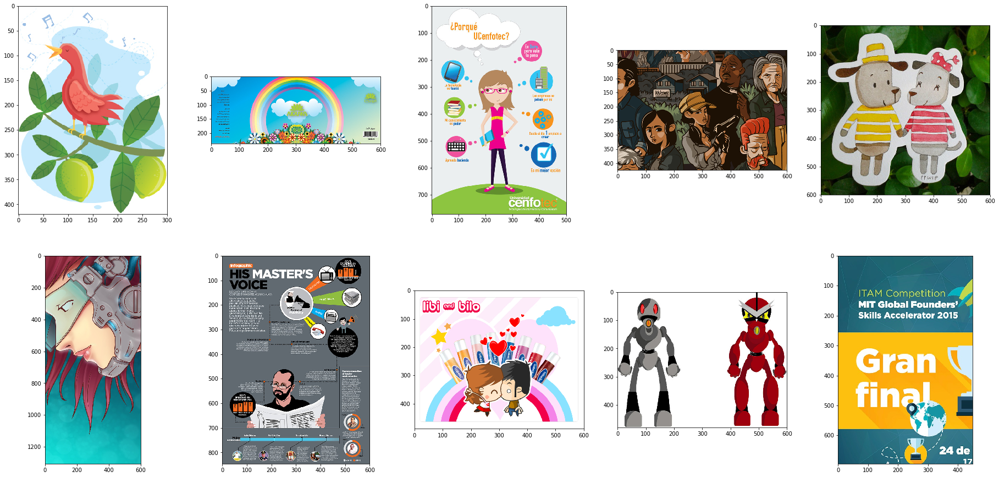

0  =  239  ( 2.165443508199692 %)
1  =  11  ( 0.09966476397571804 %)
2  =  1  ( 0.00906043308870164 %)
3  =  3177  ( 28.78499592280511 %)
4  =  4154  ( 37.63703905046661 %)
5  =  202  ( 1.8302074839177314 %)
6  =  530  ( 4.802029537011869 %)
7  =  2319  ( 21.011144332699104 %)
8  =  397  ( 3.5969919362145513 %)
9  =  1  ( 0.00906043308870164 %)
10  =  6  ( 0.05436259853220984 %)
Most Dominant Label is  4  =  4154  /  11037  ( 37.63703905046661 %)

Cluster # 5
Most dominant images:


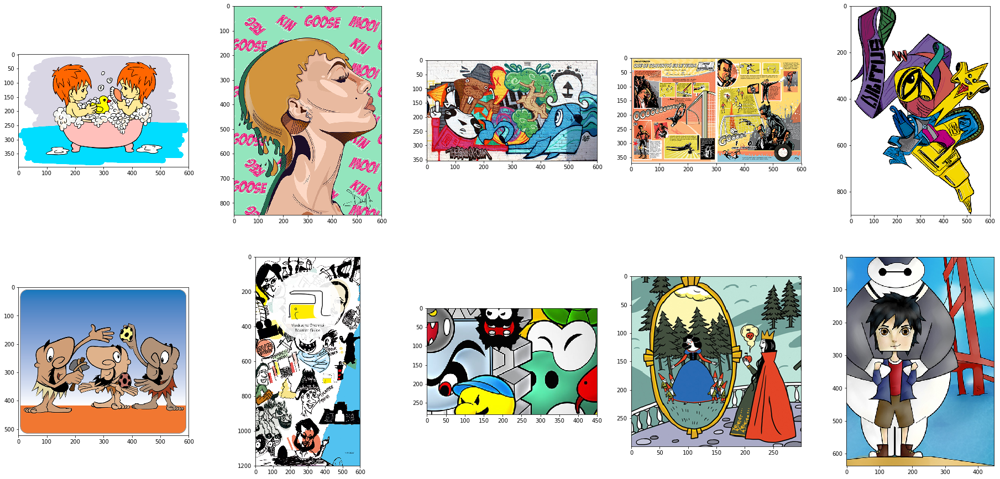

3018  images in total
Randomly sampled images:


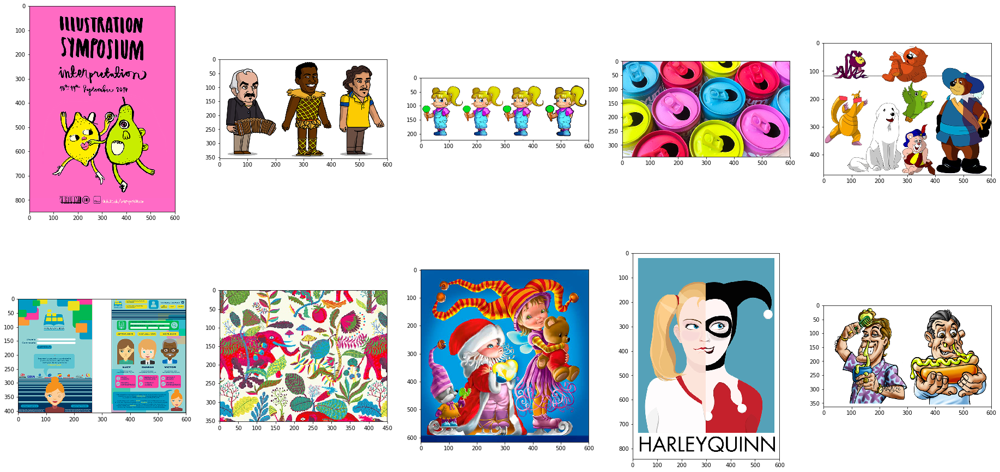

0  =  8  ( 0.26507620941020543 %)
3  =  1434  ( 47.514910536779325 %)
4  =  596  ( 19.748177601060306 %)
5  =  4  ( 0.13253810470510272 %)
6  =  12  ( 0.3976143141153082 %)
7  =  906  ( 30.019880715705764 %)
8  =  58  ( 1.9218025182239893 %)
Most Dominant Label is  3  =  1434  /  3018  ( 47.514910536779325 %)

Cluster # 6
Most dominant images:


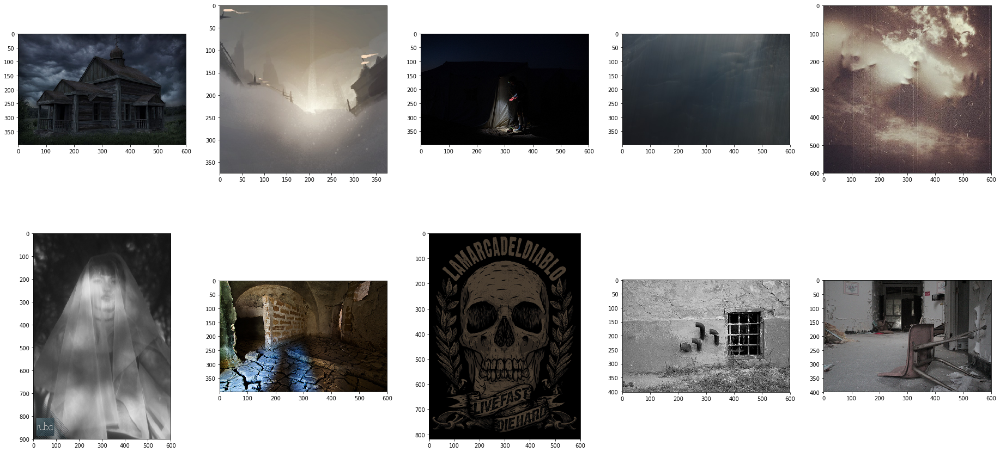

53922  images in total
Randomly sampled images:


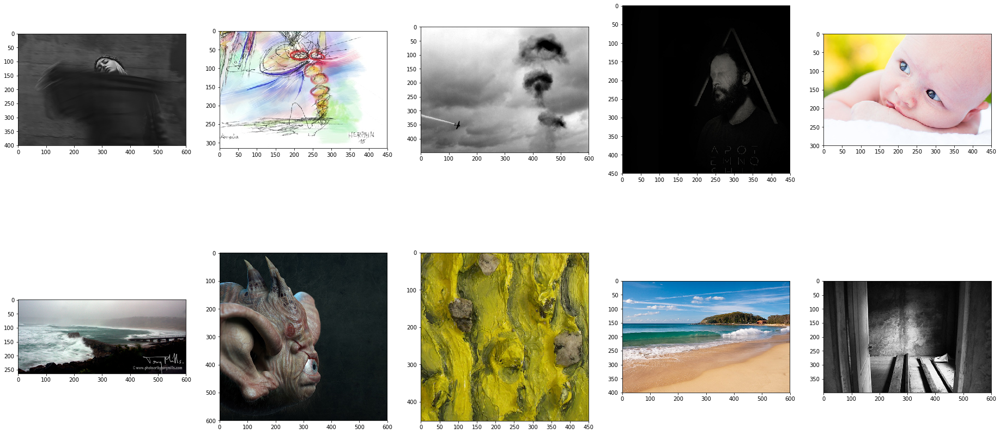

0  =  5602  ( 10.389080523719446 %)
1  =  1880  ( 3.486517562404955 %)
2  =  9123  ( 16.918882830755535 %)
3  =  266  ( 0.49330514446793516 %)
4  =  1401  ( 2.5981973962390117 %)
5  =  4918  ( 9.120581580801899 %)
6  =  4077  ( 7.560921330811172 %)
7  =  1541  ( 2.8578316828010832 %)
8  =  5400  ( 10.014465338822744 %)
9  =  10193  ( 18.903230592337078 %)
10  =  9521  ( 17.656986016839138 %)
Most Dominant Label is  9  =  10193  /  53922  ( 18.903230592337078 %)

Cluster # 7
Most dominant images:


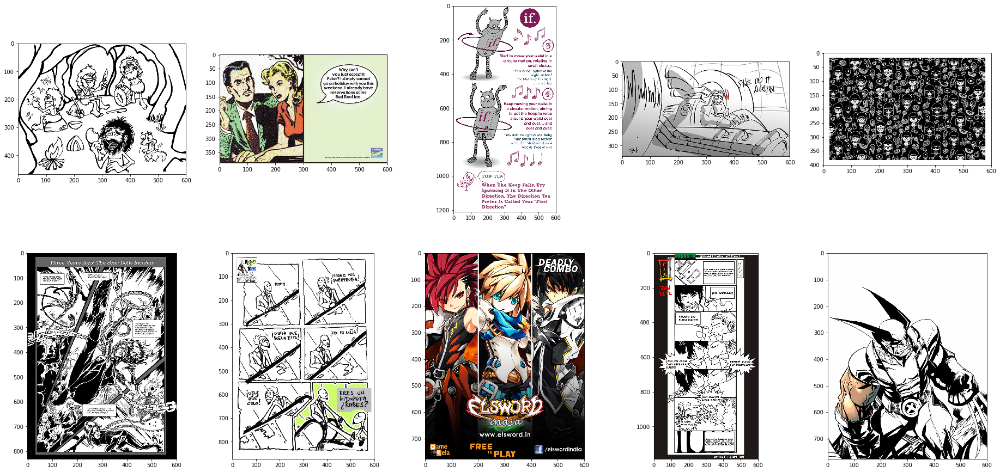

4561  images in total
Randomly sampled images:


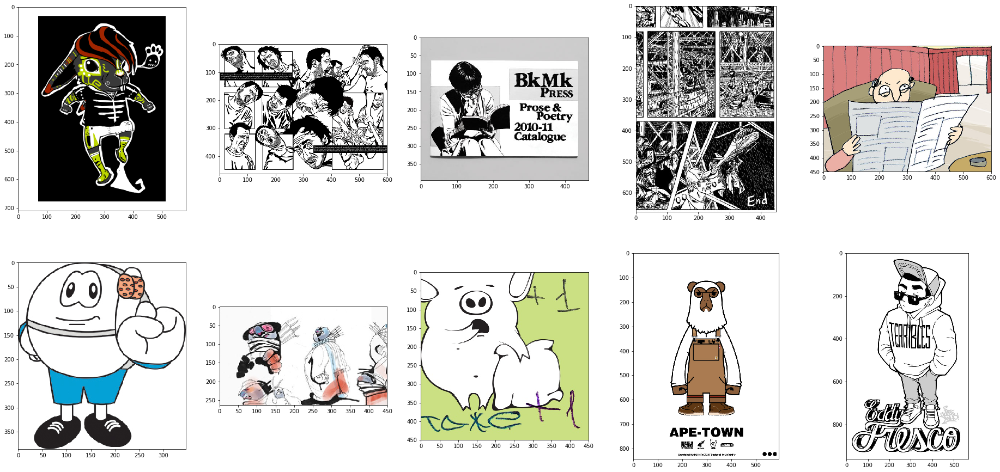

0  =  12  ( 0.263100197325148 %)
1  =  1911  ( 41.89870642402982 %)
2  =  11  ( 0.24117518088138565 %)
3  =  1958  ( 42.92918219688665 %)
4  =  117  ( 2.565226923920193 %)
5  =  1  ( 0.021925016443762334 %)
6  =  24  ( 0.526200394650296 %)
7  =  47  ( 1.0304757728568297 %)
8  =  463  ( 10.15128261346196 %)
9  =  17  ( 0.3727252795439597 %)
Most Dominant Label is  3  =  1958  /  4561  ( 42.92918219688665 %)


In [75]:
import random

for c in cluster:
    print("\nCluster #", c + 1)
    total = 0
    maxL = -1
    maxC = 0
    images = []
    for l in cluster[c]:
        total += len(cluster[c][l])
        if len(cluster[c][l]) > maxC:
            maxC = len(cluster[c][l])
            maxL = l
    
    # Dominant images
    random.shuffle(cluster[c][maxL])
    for i, img in enumerate(cluster[c][maxL]):        
#         print('/scratch/bam_subset_2_0/' + img)
        images.append(Image.open('/scratch/bam_subset_2_0_labeled/' + str(maxL) + '/' + img))
        if i == 9:
            break
    print("Most dominant images:")
    showImages(images)
    
    # Randomly sampled images
    image_names = []
    images = []
    for l in cluster[c]:
        image_names.extend(cluster[c][l])
    print(len(image_names), " images in total")
    random.shuffle(image_names)
    
    print("Randomly sampled images:")
    for i, img in enumerate(image_names):
        images.append(Image.open('/scratch/bam_subset_2_0_labeled/' + str(labels[img]) + '/' + img))
        if i == 9:
            break
    showImages(images)
    

    
    for l in cluster[c]:
        print(l, " = ", len(cluster[c][l]), " (", len(cluster[c][l]) * 100 / total, "%)")
    print("Most Dominant Label is ", maxL, " = ", maxC, " / ", total ," (", maxC * 100 / total, "%)")

    
    